# Documentation

**Spencer Ressel**

*2023.05.09*

***

This script analyses MERRA-2 renanalysis data under the framework of the Ahmed (2021) moisture tendency equation
***

## Inputs:       
                
## Dependencies: 
* mjo_mean_state_diagnostics.py

# Imports

In [29]:
# Data Processing Tools
import numpy as np
import xarray as xr
import scipy as sp
from scipy.integrate import trapz
from scipy import signal
from scipy import special

import os
os.chdir("/home/disk/eos7/sressel/research/thesis-work/python/mjo_data_analysis/")
import sys
sys.path.insert(0, '/home/disk/eos7/sressel/research/thesis-work/python/auxiliary_functions/')
import ipynb.fs.full.mjo_mean_state_diagnostics as mjo

# Matplotlib
from matplotlib import pyplot as plt
from matplotlib import colors as mcolors
from matplotlib import ticker as mticker
from matplotlib.gridspec import GridSpec

# Cartopy
from cartopy import crs as ccrs
import cartopy.feature as cfeature
from cartopy import util as cutil
from cartopy.mpl.ticker import LongitudeLocator, LatitudeLocator
from cartopy.mpl.gridliner import LongitudeFormatter, LatitudeFormatter

# Specify constants

In [3]:
# System Parameters
TIME_MIN = '1999-01-01T00:00:00.000000000'
TIME_MAX = '2018-12-31T00:00:00.000000000'
time_subset = dict(time=slice(TIME_MIN, TIME_MAX))

LONGITUDE_MIN = 60
LONGITUDE_MAX = 130

LATITUDE_SOUTH = -15
LATITUDE_NORTH = 15

PRESSURE_LOWER = 850
PRESSURE_UPPER = 200

LOWCUT = 1/100
HIGHCUT = 1/20

# Physical constants
GRAVITY = 9.81                   # m s^-2
WATER_DENSITY = 997              # kg m^-3
LATENT_HEAT = 2.26*10**6         # J kg^-1 K^-1
SPECIFIC_HEAT = 1004             # J kg^-1
GAS_CONSTANT = 287               # J kg^-1 K^-1

LAT_TO_DISTANCE = 111*10**3 # meters per degree latitude 

# Customized colormap
cmap_modified = mjo.modified_colormap('coolwarm', 'white', 0.2, 0.1)

# Load data

In [59]:
# Specify data location
data_folder = r"/home/disk/eos7/sressel/research/data/NASA/MERRA2/"
file_name = r"merra2_data.nc"
data = xr.open_dataset(data_folder+file_name, engine="netcdf4")

# Moisture 
moisture = data['QV'].sel(time_subset).drop_duplicates(dim='time').sortby('lat')
moisture['lon'] = (moisture['lon'] + 360) % 360
moisture = moisture.sortby('lon')

# Temperature
temperature = data['T'].sel(time_subset).drop_duplicates(dim='time').sortby('lat')
temperature['lon'] = (temperature['lon'] + 360) % 360
temperature = temperature.sortby('lon')

# Zonal velocity
zonal_wind = data['U'].sel(time_subset).drop_duplicates(dim='time').sortby('lat')
zonal_wind['lon'] = (zonal_wind['lon'] + 360) % 360
zonal_wind = zonal_wind.sortby('lon')

# Meridional wind
meridional_wind = data['V'].sel(time_subset).drop_duplicates(dim='time').sortby('lat')
meridional_wind['lon'] = (meridional_wind['lon'] + 360) % 360
meridional_wind = meridional_wind.sortby('lon')

# Vertical wind
vertical_wind = data['OMEGA'].sel(time_subset).drop_duplicates(dim='time').sortby('lat')
vertical_wind['lon'] = (vertical_wind['lon'] + 360) % 360
vertical_wind = vertical_wind.sortby('lon')

# Precipitation
# precipitation_data = xr.open_dataset(data_folder+'MERRA2_precip.nc')['PRECTOT']
precipitation_data = xr.open_dataset(data_folder+'merra2_pr.nc')['pr']
precipitation = xr.DataArray(precipitation_data.values,
                    dims=['time', 'lat', 'lon'],
                    coords={
                        'time':np.arange(
                            np.datetime64('1999-01-01T00:00:00.000000000'), 
                            np.datetime64('2019-01-01T00:00:00.000000000'), 
                            np.timedelta64(1, "D")
                            ),
                        'lat':precipitation_data.lat,
                        'lon':precipitation_data.lon},
                    attrs={
                    'units':'kg m-2 s-1'
                    }
                   )
precipitation = precipitation.sel(time_subset).drop_duplicates(dim='time').sortby('lat')

dates_by_phase = xr.open_dataset('/home/disk/eos7/sressel/research/data/dates_by_mjo_phase.nc')['time']
dates_by_phase = dates_by_phase.where(~dates_by_phase.isin(time_subset)).dropna(dim='phase')

In [96]:
precipitation.time

<xarray.DataArray 'time' (time: 7305)>
array(['1999-01-01T00:00:00.000000000', '1999-01-02T00:00:00.000000000',
       '1999-01-03T00:00:00.000000000', ..., '2018-12-29T00:00:00.000000000',
       '2018-12-30T00:00:00.000000000', '2018-12-31T00:00:00.000000000'],
      dtype='datetime64[ns]')
Coordinates:
  * time     (time) datetime64[ns] 1999-01-01 1999-01-02 ... 2018-12-31

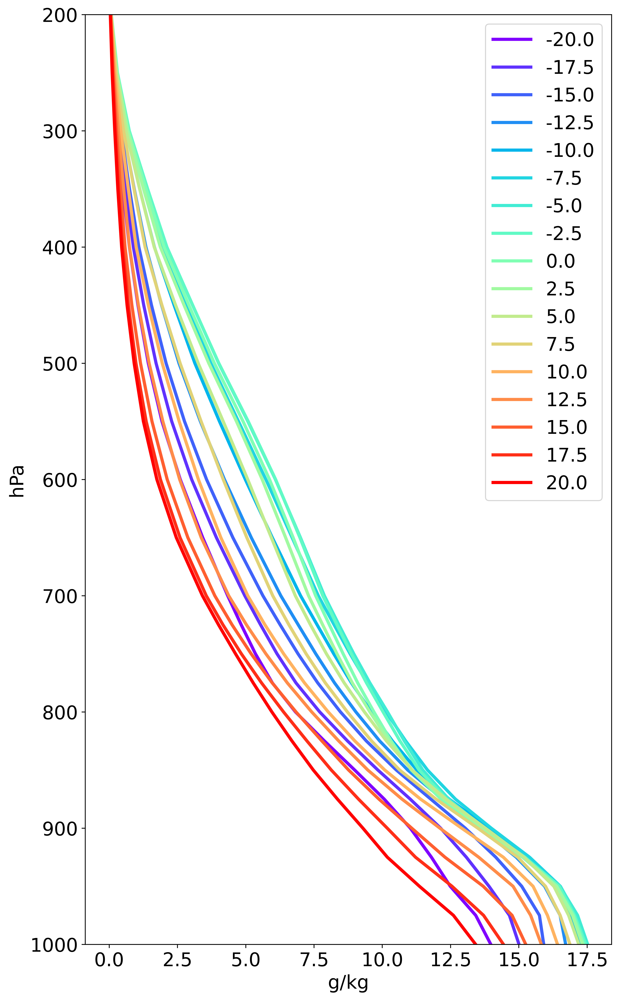

In [60]:
moisture = data['QV'].sel(time_subset).drop_duplicates(dim='time').sortby('lat')
moisture['lon'] = (moisture['lon'] + 360) % 360
moisture = moisture.sortby('lon')

moisture = moisture.sel(time=slice('2002-01-01T00:00:00.000000000', '2014-01-01T00:00:00.000000000'))
moisture = moisture.where(moisture["time.month"].isin([1,2,3,4,11,12]), drop=True)
vertical_profiles = moisture.sel(lon=slice(60,160)).mean(dim=['lon', 'time'])

from matplotlib import cm
colors = cm.rainbow(np.linspace(0, 1, len(vertical_profiles.lat)))
plt.rcParams.update({'font.size':18})
plt.figure(figsize=(9,16), dpi=500)
for index, lat in enumerate(vertical_profiles.lat): 
    plt.plot(
        # 1000*vertical_profiles.sel(lat=lat).differentiate('lev'), 
        1000*vertical_profiles.sel(lat=lat), 
        vertical_profiles.lev, 
        label=lat.values,
        color=colors[index],
        lw=3
    )
plt.legend()
plt.xlabel(r'g/kg')
plt.ylabel('hPa')
plt.ylim(1000, 200)
plt.show()

# Analyze budget terms

## Advection of Mean Moisture

### Calculate background moisture field and anomalies

In [4]:
# Calculate mean fields
mean_zonal_wind = zonal_wind.mean(dim='time')
mean_meridional_wind = meridional_wind.mean(dim='time')
mean_vertical_wind = vertical_wind.mean(dim='time')
mean_moisture = moisture.mean(dim='time')

# Anomalies
zonal_wind_anomalies = zonal_wind - mean_zonal_wind
meridional_wind_anomalies = meridional_wind - mean_meridional_wind
vertical_wind_anomalies = vertical_wind -  mean_vertical_wind
moisture_anomalies = moisture -  mean_moisture

### Calculate gradients of mean moisture field

In [5]:
zonal_gradient_mean_moisture = mean_moisture.differentiate('lon')
meridional_gradient_mean_moisture = mean_moisture.differentiate('lat')
vertical_gradient_mean_moisture = mean_moisture.differentiate('lev')

### Calculate advection of background moisture field

In [6]:
zonal_advection_mean_moisture = zonal_wind.copy(deep=True)
zonal_advection_mean_moisture.values = np.einsum(
    'ijkl,jkl->ijkl',
    zonal_wind_anomalies.values,
    zonal_gradient_mean_moisture.values
)

meridional_advection_mean_moisture = meridional_wind.copy(deep=True)
meridional_advection_mean_moisture.values = np.einsum(
    'ijkl,jkl->ijkl',
    meridional_wind_anomalies.values,
    meridional_gradient_mean_moisture.values
)

vertical_advection_mean_moisture = vertical_wind.copy(deep=True)
vertical_advection_mean_moisture.values = np.einsum(
    'ijkl,jkl->ijkl',
    vertical_wind_anomalies.values,
    vertical_gradient_mean_moisture.values
)

### Column integrate advection of background moisture field

In [8]:
def column_integrate(variable):
    return -(100/GRAVITY)*variable.integrate('lev')

In [12]:
# Moisture Anomalies
column_integrated_moisture_anomalies = column_integrate(moisture_anomalies.fillna(0))
column_integrated_moisture_tendency = column_integrated_moisture_anomalies.differentiate('time', datetime_unit='D')

# Zonal advection of mean moisture 
column_integrated_zonal_advection_mean_moisture = column_integrate(zonal_advection_mean_moisture.fillna(0))

# Meridional advection of mean moisture
column_integrated_meridional_advection_mean_moisture = column_integrate(meridional_advection_mean_moisture.fillna(0))

# Vertical advection of mean moisture
column_integrated_vertical_advection_mean_moisture = column_integrate(vertical_advection_mean_moisture.fillna(0))

# Plot budget terms by MJO Phase

### Moisture Tendency

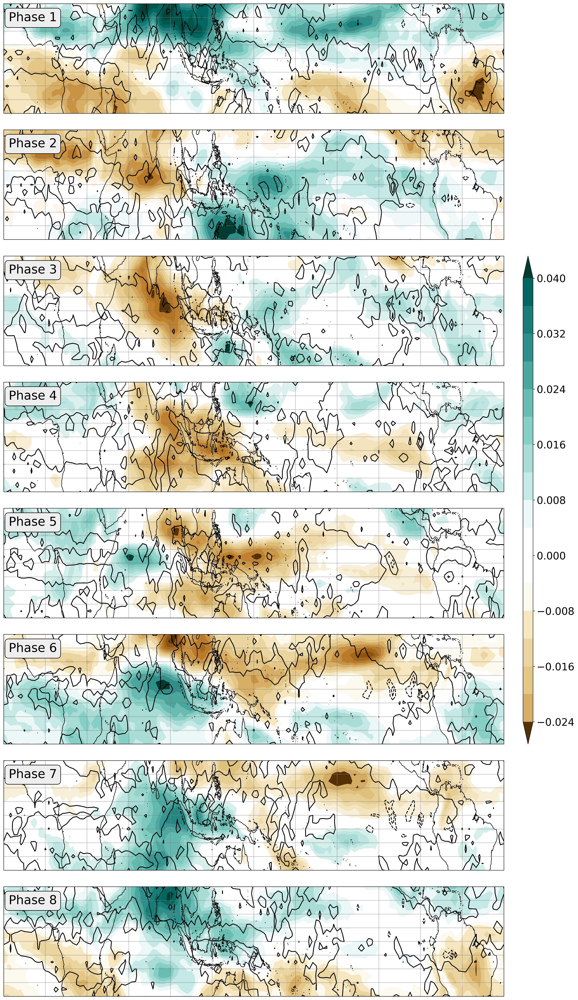

In [82]:
plt.style.use('default')
plt.rcParams.update({'font.size':24})
plt.rcParams['figure.dpi']= 300
coastline_width = 1
props = dict(boxstyle='round', facecolor='#eeeeee')

gs = GridSpec(8,2, width_ratios=[100,2])
gs.update(top=.95, bottom=0.05, left=0.05, right=.95, hspace=0.15, wspace=0.075)
fig = plt.figure(figsize=(16, 30))

cmap_modified = mjo.modified_colormap('BrBG', 'white', 0.1, 0.1)

keyword_args = {
    'transform':ccrs.PlateCarree(),
    'cmap':cmap_modified,
    # 'levels':np.linspace(-4, 4, 21),
    "levels":21,
    'norm':mcolors.CenteredNorm(vcenter=0),
    'extend':'both'
}

for p in range(1,9):
    # Add an axis object for each phase
    ax = fig.add_subplot(gs[p-1, 0], projection=ccrs.PlateCarree(central_longitude=-210))

    # Plot rainfall by phase
    im = ax.contourf(
        column_integrated_moisture_anomalies.lon, 
        column_integrated_moisture_anomalies.lat,
        column_integrated_moisture_anomalies.sel(time=zonal_wind.time.isin(dates_by_phase.sel(phase=p).values)).mean(dim='time'),
        **keyword_args
        # transform=ccrs.PlateCarree(), 
        # cmap=cmap_modified,
        # levels=21,
        # norm=mcolors.CenteredNorm()
    )    

    # Add the cyclic point
    cdata, clon = cutil.add_cyclic_point(
        column_integrated_moisture_anomalies.sel(time=zonal_wind.time.isin(dates_by_phase.sel(phase=p).values)).mean(dim='time'),
        coord=column_integrated_moisture_anomalies.lon
    )

    ax.contourf(
        clon, 
        column_integrated_moisture_anomalies.lat, 
        cdata, 
        **keyword_args
        # transform=ccrs.PlateCarree(), 
        # cmap=cmap_modified,
        # levels=21,
        # norm=mcolors.CenteredNorm()
    )
    
    # Plot rainfall by phase
    ax.contour(
        precipitation.lon, 
        precipitation.lat,
        3600*precipitation_anomalies.sel(time=precipitation.time.isin(dates_by_phase.sel(phase=p).values)).mean(dim='time'),
        colors='black',
        levels=np.linspace(-0.25, 0.25, 5),
        norm=mcolors.CenteredNorm(vcenter=0)
    )    

    # Add the cyclic point
    cdata, clon = cutil.add_cyclic_point(
        3600*precipitation_anomalies.sel(time=precipitation.time.isin(dates_by_phase.sel(phase=p).values)).mean(dim='time'),
        coord=precipitation.lon
    )

    ax.contour(
        clon, 
        precipitation.lat, 
        cdata, 
        colors='black',
        levels=np.linspace(-0.25, 0.25, 5),
        norm=mcolors.CenteredNorm(vcenter=0)
    )

    # Map parameters
    ax.set_xlabel('')
    ax.add_feature(cfeature.COASTLINE, lw=coastline_width)

    gl = ax.gridlines(
        crs=ccrs.PlateCarree(),
        draw_labels=True,
        linewidth=1,
        color="gray",
        alpha=0.5,
        linestyle="-",

    )
    gl.right_labels = False
    gl.top_labels = False
    gl.xlocator = mticker.FixedLocator(np.arange(-180,180,30))
    # gl.xlocator = LongitudeLocator(30)
    gl.xformatter = LongitudeFormatter()
    gl.xlabel_style = {'fontsize':20}
    # gl.ylocator = mticker.FixedLocator(np.arange(-15,15,5))
    # gl.yformatter = LatitudeFormatter()
    # gl.ylabel_style = {'fontsize':20}
        
    # Label the phase in the top left corner
    ax.text(
        0.01, 
        0.925, 
        f'Phase {p:0.0f}', 
        horizontalalignment='left',
        verticalalignment='top', 
        transform=ax.transAxes, 
        bbox=props
    )
    
    ax.set_aspect('auto')
    
# Set colorbar
cbar_ax = fig.add_subplot(gs[2:-2,1])
cbar = fig.colorbar(im, cax=cbar_ax)
cbar.ax.tick_params(labelsize=20)
# cbar.set_label(r'mm day$^{-1}$')
    
plt.show()

### Zonal advection of mean moisture

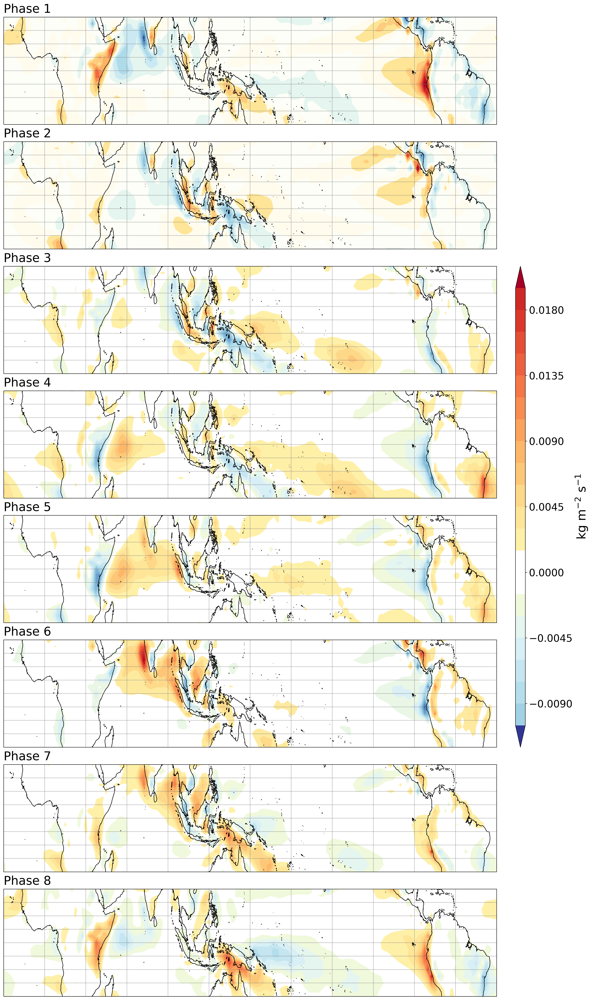

In [130]:
plt.style.use('default')
plt.rcParams.update({'font.size':24})
plt.rcParams['figure.dpi']= 300
coastline_width = 1
props = dict(boxstyle='square', facecolor='#ffffff')

gs = GridSpec(8,2, width_ratios=[100,2])
gs.update(top=.95, bottom=0.05, left=0.05, right=.95, hspace=0.16, wspace=0.075)
fig = plt.figure(figsize=(16, 30))

cmap_modified = mjo.modified_colormap('RdYlBu_r', 'white', 0.05, 0.05)

keyword_args = {
    'transform':ccrs.PlateCarree(),
    'cmap':cmap_modified,
    # 'levels':np.linspace(-4, 4, 21),
    "levels":21,
    'norm':mcolors.CenteredNorm(vcenter=0),
    'extend':'both'
}

for p in range(1,9):
    # Add an axis object for each phase
    ax = fig.add_subplot(gs[p-1, 0], projection=ccrs.PlateCarree(central_longitude=-210))

    # Plot rainfall by phase
    im = ax.contourf(
        column_integrated_zonal_advection_mean_moisture.lon, 
        column_integrated_zonal_advection_mean_moisture.lat,
        column_integrated_zonal_advection_mean_moisture.sel(time=zonal_wind.time.isin(dates_by_phase.sel(phase=p).values)).mean(dim='time'),
        **keyword_args
        # transform=ccrs.PlateCarree(), 
        # cmap=cmap_modified,
        # levels=21,
        # norm=mcolors.CenteredNorm()
    )    

    # Add the cyclic point
    cdata, clon = cutil.add_cyclic_point(
        column_integrated_zonal_advection_mean_moisture.sel(time=zonal_wind.time.isin(dates_by_phase.sel(phase=p).values)).mean(dim='time'),
        coord=column_integrated_zonal_advection_mean_moisture.lon
    )

    ax.contourf(
        clon, 
        column_integrated_zonal_advection_mean_moisture.lat, 
        cdata, 
        **keyword_args
        # transform=ccrs.PlateCarree(), 
        # cmap=cmap_modified,
        # levels=21,
        # norm=mcolors.CenteredNorm()
    )

    # Map parameters
    ax.set_xlabel('')
    ax.add_feature(cfeature.COASTLINE, lw=coastline_width)

    gl = ax.gridlines(
        crs=ccrs.PlateCarree(),
        draw_labels=True,
        linewidth=1,
        color="gray",
        alpha=0.5,
        linestyle="-",

    )
    gl.right_labels = False
    gl.top_labels = False
    gl.xlocator = mticker.FixedLocator(np.arange(-180,180,30))
    # gl.xlocator = LongitudeLocator(30)
    gl.xformatter = LongitudeFormatter()
    gl.xlabel_style = {'fontsize':20}
    # gl.ylocator = mticker.FixedLocator(np.arange(-15,15,5))
    # gl.yformatter = LatitudeFormatter()
    # gl.ylabel_style = {'fontsize':20}
        
    # Label the phase in the top left corner
    ax.text(
        0., 
        1.125, 
        f'Phase {p:0.0f}', 
        horizontalalignment='left',
        verticalalignment='top', 
        transform=ax.transAxes,
        # bbox=props
    )
    
    ax.set_aspect('auto')
    
# Set colorbar
cbar_ax = fig.add_subplot(gs[2:-2,1])
cbar = fig.colorbar(im, cax=cbar_ax)
cbar.ax.tick_params(labelsize=20)
cbar.set_label(r'kg m$^{-2}$ s$^{-1}$')
    
plt.show()

### Meridional advection of mean moisture

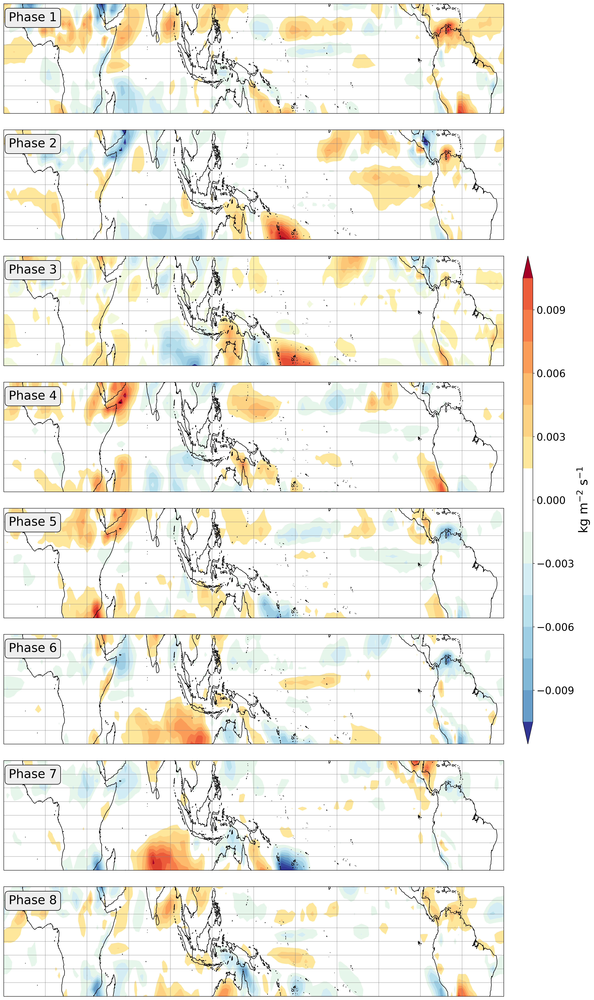

In [115]:
plt.style.use('default')
plt.rcParams.update({'font.size':24})
plt.rcParams['figure.dpi']= 300
coastline_width = 1
props = dict(boxstyle='round', facecolor='#eeeeee')

gs = GridSpec(8,2, width_ratios=[100,2])
gs.update(top=.95, bottom=0.05, left=0.05, right=.95, hspace=0.15, wspace=0.075)
fig = plt.figure(figsize=(16, 30))

cmap_modified = mjo.modified_colormap('RdYlBu_r', 'white', 0.05, 0.05)

keyword_args = {
    'transform':ccrs.PlateCarree(),
    'cmap':cmap_modified,
    # 'levels':np.linspace(-4, 4, 21),
    "levels":21,
    'norm':mcolors.CenteredNorm(vcenter=0),
    'extend':'both'
}

for p in range(1,9):
    # Add an axis object for each phase
    ax = fig.add_subplot(gs[p-1, 0], projection=ccrs.PlateCarree(central_longitude=-210))

    # Plot rainfall by phase
    im = ax.contourf(
        column_integrated_meridional_advection_mean_moisture.lon, 
        column_integrated_meridional_advection_mean_moisture.lat,
        column_integrated_meridional_advection_mean_moisture.sel(time=meridional_wind.time.isin(dates_by_phase.sel(phase=p).values)).mean(dim='time'),
        **keyword_args
        # transform=ccrs.PlateCarree(), 
        # cmap=cmap_modified,
        # levels=21,
        # norm=mcolors.CenteredNorm()
    )    

    # Add the cyclic point
    cdata, clon = cutil.add_cyclic_point(
        column_integrated_meridional_advection_mean_moisture.sel(time=meridional_wind.time.isin(dates_by_phase.sel(phase=p).values)).mean(dim='time'),
        coord=column_integrated_meridional_advection_mean_moisture.lon
    )

    ax.contourf(
        clon, 
        column_integrated_meridional_advection_mean_moisture.lat, 
        cdata, 
        **keyword_args
        # transform=ccrs.PlateCarree(), 
        # cmap=cmap_modified,
        # levels=21,
        # norm=mcolors.CenteredNorm()
    )

    # Map parameters
    ax.set_xlabel('')
    ax.add_feature(cfeature.COASTLINE, lw=coastline_width)

    gl = ax.gridlines(
        crs=ccrs.PlateCarree(),
        draw_labels=True,
        linewidth=1,
        color="gray",
        alpha=0.5,
        linestyle="-",

    )
    gl.right_labels = False
    gl.top_labels = False
    gl.xlocator = mticker.FixedLocator(np.arange(-180,180,30))
    # gl.xlocator = LongitudeLocator(30)
    gl.xformatter = LongitudeFormatter()
    gl.xlabel_style = {'fontsize':20}
    # gl.ylocator = mticker.FixedLocator(np.arange(-15,15,5))
    # gl.yformatter = LatitudeFormatter()
    # gl.ylabel_style = {'fontsize':20}
        
    # Label the phase in the top left corner
    ax.text(
        0.01, 
        0.925, 
        f'Phase {p:0.0f}', 
        horizontalalignment='left',
        verticalalignment='top', 
        transform=ax.transAxes, 
        bbox=props
    )
    
    ax.set_aspect('auto')
    
# Set colorbar
cbar_ax = fig.add_subplot(gs[2:-2,1])
cbar = fig.colorbar(im, cax=cbar_ax)
cbar.ax.tick_params(labelsize=20)
cbar.set_label(r'kg m$^{-2}$ s$^{-1}$')
    
plt.show()

### Vertical advection of mean moisture

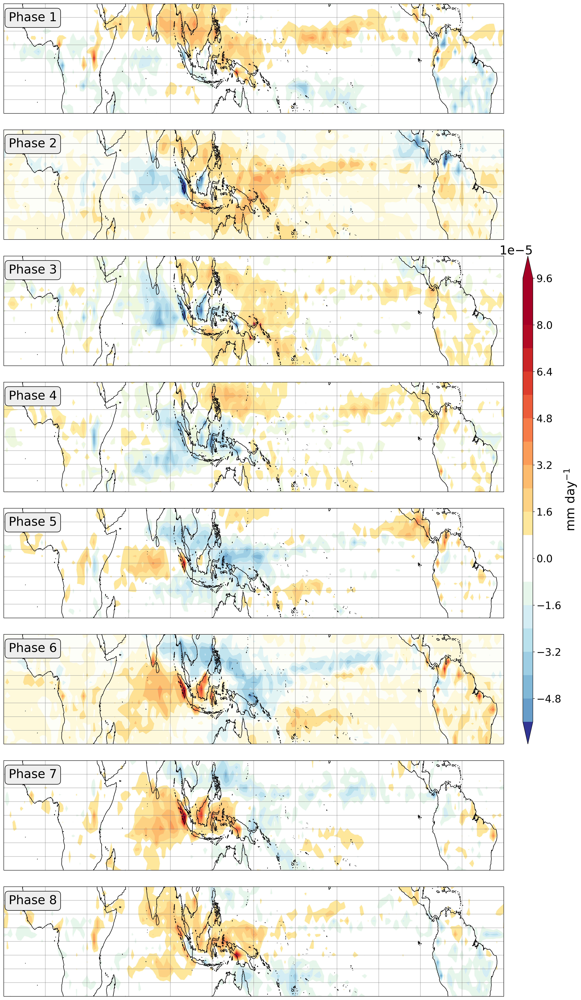

In [114]:
plt.style.use('default')
plt.rcParams.update({'font.size':24})
plt.rcParams['figure.dpi']= 300
coastline_width = 1
props = dict(boxstyle='round', facecolor='#eeeeee')

gs = GridSpec(8,2, width_ratios=[100,2])
gs.update(top=.95, bottom=0.05, left=0.05, right=.95, hspace=0.15, wspace=0.075)
fig = plt.figure(figsize=(16, 30))

cmap_modified = mjo.modified_colormap('RdYlBu_r', 'white', 0.05, 0.05)

keyword_args = {
    'transform':ccrs.PlateCarree(),
    'cmap':cmap_modified,
    # 'levels':np.linspace(-4, 4, 21),
    "levels":21,
    'norm':mcolors.CenteredNorm(vcenter=0),
    'extend':'both'
}

for p in range(1,9):
    # Add an axis object for each phase
    ax = fig.add_subplot(gs[p-1, 0], projection=ccrs.PlateCarree(central_longitude=-210))

    # Plot rainfall by phase
    im = ax.contourf(
        column_integrated_vertical_advection_mean_moisture.lon, 
        column_integrated_vertical_advection_mean_moisture.lat,
        column_integrated_vertical_advection_mean_moisture.sel(time=vertical_wind.time.isin(dates_by_phase.sel(phase=p).values)).mean(dim='time'),
        **keyword_args
        # transform=ccrs.PlateCarree(), 
        # cmap=cmap_modified,
        # levels=21,
        # norm=mcolors.CenteredNorm()
    )    

    # Add the cyclic point
    cdata, clon = cutil.add_cyclic_point(
        column_integrated_vertical_advection_mean_moisture.sel(time=vertical_wind.time.isin(dates_by_phase.sel(phase=p).values)).mean(dim='time'),
        coord=column_integrated_vertical_advection_mean_moisture.lon
    )

    ax.contourf(
        clon, 
        column_integrated_vertical_advection_mean_moisture.lat, 
        cdata, 
        **keyword_args
        # transform=ccrs.PlateCarree(), 
        # cmap=cmap_modified,
        # levels=21,
        # norm=mcolors.CenteredNorm()
    )

    # Map parameters
    ax.set_xlabel('')
    ax.add_feature(cfeature.COASTLINE, lw=coastline_width)

    gl = ax.gridlines(
        crs=ccrs.PlateCarree(),
        draw_labels=True,
        linewidth=1,
        color="gray",
        alpha=0.5,
        linestyle="-",

    )
    gl.right_labels = False
    gl.top_labels = False
    gl.xlocator = mticker.FixedLocator(np.arange(-180,180,30))
    # gl.xlocator = LongitudeLocator(30)
    gl.xformatter = LongitudeFormatter()
    gl.xlabel_style = {'fontsize':20}
    # gl.ylocator = mticker.FixedLocator(np.arange(-15,15,5))
    # gl.yformatter = LatitudeFormatter()
    # gl.ylabel_style = {'fontsize':20}
        
    # Label the phase in the top left corner
    ax.text(
        0.01, 
        0.925, 
        f'Phase {p:0.0f}', 
        horizontalalignment='left',
        verticalalignment='top', 
        transform=ax.transAxes, 
        bbox=props
    )
    
    ax.set_aspect('auto')
    
# Set colorbar
cbar_ax = fig.add_subplot(gs[2:-2,1])
cbar = fig.colorbar(im, cax=cbar_ax)
cbar.ax.tick_params(labelsize=20)
cbar.set_label(r'kg m$^{-2}$ s$^{-1}$')
    
plt.show()

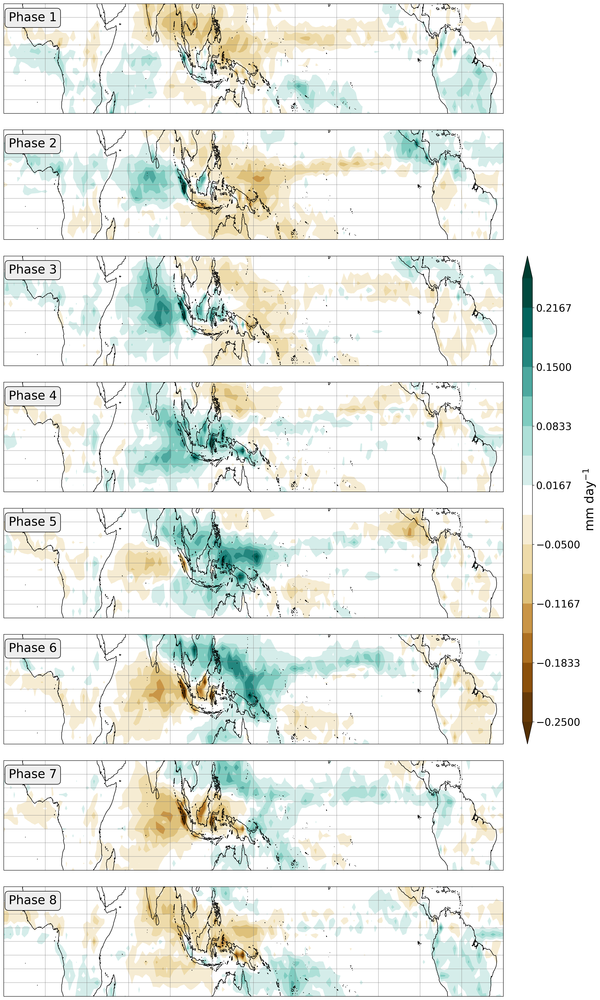

In [77]:
plt.style.use('default')
plt.rcParams.update({'font.size':24})
plt.rcParams['figure.dpi']= 300
coastline_width = 1
props = dict(boxstyle='round', facecolor='#eeeeee')

gs = GridSpec(8,2, width_ratios=[100,2])
gs.update(top=.95, bottom=0.05, left=0.05, right=.95, hspace=0.15, wspace=0.075)
fig = plt.figure(figsize=(16, 30))

cmap_modified = mjo.modified_colormap('BrBG', 'white', 0.05, 0.05)

keyword_args = {
    'transform':ccrs.PlateCarree(),
    'cmap':cmap_modified,
    'norm':mcolors.CenteredNorm(vcenter=0),
    # 'norm':mcolors.LogNorm(),
    'levels':np.linspace(-0.25, 0.25, 16),
    'extend':'both',
}

precipitation_anomalies = precipitation - precipitation.mean(dim='time')

for p in range(1,9):
    # Add an axis object for each phase
    ax = fig.add_subplot(gs[p-1, 0], projection=ccrs.PlateCarree(central_longitude=-210))

    # Plot rainfall by phase
    im = ax.contourf(
        precipitation.lon, 
        precipitation.lat,
        (1000*3600/1000)*precipitation_anomalies.sel(time=precipitation.time.isin(dates_by_phase.sel(phase=p).values)).mean(dim='time'),
        **keyword_args
        # transform=ccrs.PlateCarree(), 
        # cmap=cmap_modified,
        # levels=21,
        # norm=mcolors.CenteredNorm()
    )    

    # Add the cyclic point
    cdata, clon = cutil.add_cyclic_point(
        (1000*3600/1000)*precipitation_anomalies.sel(time=precipitation.time.isin(dates_by_phase.sel(phase=p).values)).mean(dim='time'),
        coord=precipitation.lon
    )

    ax.contourf(
        clon, 
        precipitation.lat, 
        cdata, 
        **keyword_args
        # transform=ccrs.PlateCarree(), 
        # cmap=cmap_modified,
        # levels=21,
        # norm=mcolors.CenteredNorm()
    )

    # Map parameters
    ax.set_xlabel('')
    ax.add_feature(cfeature.COASTLINE, lw=coastline_width)

    gl = ax.gridlines(
        crs=ccrs.PlateCarree(),
        draw_labels=True,
        linewidth=1,
        color="gray",
        alpha=0.5,
        linestyle="-",

    )
    gl.right_labels = False
    gl.top_labels = False
    gl.xlocator = mticker.FixedLocator(np.arange(-180,180,30))
    # gl.xlocator = LongitudeLocator(30)
    gl.xformatter = LongitudeFormatter()
    gl.xlabel_style = {'fontsize':20}
    # gl.ylocator = mticker.FixedLocator(np.arange(-15,15,5))
    # gl.yformatter = LatitudeFormatter()
    # gl.ylabel_style = {'fontsize':20}
        
    # Label the phase in the top left corner
    ax.text(
        0.01, 
        0.925, 
        f'Phase {p:0.0f}', 
        horizontalalignment='left',
        verticalalignment='top', 
        transform=ax.transAxes, 
        bbox=props
    )
    
    ax.set_aspect('auto')
    
# Set colorbar
cbar_ax = fig.add_subplot(gs[2:-2,1])
cbar = fig.colorbar(im, cax=cbar_ax)
cbar.ax.tick_params(labelsize=20)
cbar.set_label(r'mm day$^{-1}$')
    
plt.show()

# Identify convective region

## Calculate geopotential height and DSE

In [20]:
geopotential_height = temperature.copy(deep=True)
temperature_filled = temperature.fillna(0)
for index, level in enumerate(temperature.lev.values):
    geopotential_height[:, index, :, :] = -(GAS_CONSTANT/GRAVITY)*trapz(
        temperature_filled.sel(lev=slice(1000, level)).values, 
        np.log(temperature_filled.lev.sel(lev=slice(1000, level))), 
        axis=1
    )
    
dry_static_energy = SPECIFIC_HEAT*temperature + GRAVITY*geopotential_height

## Calculate column-integrated vertical DSE advection

In [25]:
# Calculate vertical DSE advection
vertical_dry_static_energy_advection = vertical_wind*dry_static_energy.differentiate('lev')
vertical_dry_static_energy_advection_filled = vertical_dry_static_energy_advection.fillna(0)

# Subselect JJA
vertical_dry_static_energy_advection_filled = vertical_dry_static_energy_advection_filled.sel(
    time=vertical_dry_static_energy_advection_filled['time.month'].isin([6, 7, 8])
)

# Column integrated vertical DSE advection
column_integrated_vertical_dry_static_energy_advection = column_integrate(vertical_dry_static_energy_advection_filled)/100

## Plot mean column-integrated vertical DSE advection (Fig. 1 in Inoue et al 2021)

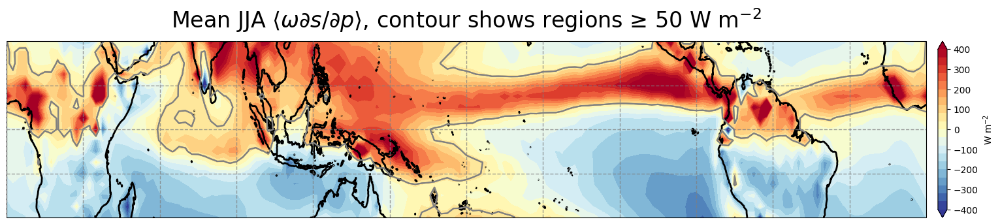

In [26]:
plt.rcParams.update({'font.size':20})
cmap_modified = mjo.modified_colormap('coolwarm', 'white', 0.2, 0.1)


fig = plt.figure(figsize=(16, 3))
gs = GridSpec(1, 2, width_ratios = [100,1])
gs.update(top=.95, bottom=0.05, left=0.05, right=.95, hspace=0, wspace=0.025)
ax = fig.add_subplot(gs[0], projection=ccrs.PlateCarree(central_longitude=-180))
cbar_ax = fig.add_subplot(gs[1])

ax.set_title(
    r'Mean JJA $\langle \omega \partial s / \partial p \rangle$, contour shows regions ≥ 50 W m$^{-2}$', 
    pad=15
)

DSE_advection_keywords = {
    'transform':ccrs.PlateCarree(),
    'cmap':'RdYlBu_r',
    'norm':mcolors.CenteredNorm(),
    'levels':np.linspace(-400, 400, 21),
    'extend':'both'
}

# Plot contourf
cf = ax.contourf(
    column_integrated_vertical_dry_static_energy_advection.lon, 
    column_integrated_vertical_dry_static_energy_advection.lat, 
    column_integrated_vertical_dry_static_energy_advection.mean(dim='time'),
    **DSE_advection_keywords
)

# Colorbar
cbar = fig.colorbar(cf, cax=cbar_ax, ticks=np.arange(-400, 500, 100))
cbar.set_label(r'W m$^{-2}$', fontsize=10)
cbar.ax.tick_params(labelsize=10)

# Add cyclic point
cdata, clon = cutil.add_cyclic_point(
    column_integrated_vertical_dry_static_energy_advection.mean(dim='time'),
    coord=column_integrated_vertical_dry_static_energy_advection.lon
)

ax.contourf(
    clon, 
    column_integrated_vertical_dry_static_energy_advection.lat, 
    cdata, 
    **DSE_advection_keywords
)


# Add 50 W/m^2 contour
ax.contour(
    column_integrated_vertical_dry_static_energy_advection.lon, 
    column_integrated_vertical_dry_static_energy_advection.lat, 
    column_integrated_vertical_dry_static_energy_advection.mean(dim='time'),
    transform=ccrs.PlateCarree(),
    levels=[50],
    colors='gray', 
)

ax.contour(
    clon, 
    column_integrated_vertical_dry_static_energy_advection.lat, 
    cdata, 
    transform=ccrs.PlateCarree(),
    levels=[50],
    colors='gray'
)


ax.add_feature(cfeature.COASTLINE, lw=2)

gl = ax.gridlines(
    crs=ccrs.PlateCarree(),
    draw_labels=True,
    linewidth=1,
    color="gray",
    alpha=0.75,
    linestyle="--",
    zorder=100
    )

gl.xlocator = mticker.FixedLocator(np.arange(-180,180,30))
gl.xformatter = LongitudeFormatter()
gl.xlabel_style = {'fontsize':20}
gl.ylocator = mticker.FixedLocator(np.arange(-40,40,10))
gl.yformatter = LatitudeFormatter()
gl.ylabel_style = {'fontsize':20}


ax.set_aspect('auto')

## Remove vertical velocity profiles outside of convective region

In [28]:
vertical_wind_convective_region = vertical_wind.where(
    column_integrated_vertical_dry_static_energy_advection.mean(dim='time') > 50
)
vertical_wind_convective_region_stacked = vertical_wind_convective_region.stack(
    index=('time', 'lat','lon')
).dropna(dim='index')

## EOF Analysis on vertical velocity profiles in convective region

In [29]:
[
    EOF, 
    PC, 
    eigval, 
    eigval_explained_var, 
    eigval_err, 
    dof, 
    phi_0, 
    phi_L
] = mjo.eof(vertical_wind_convective_region_stacked.values)

### Plot of Eigenvalue Spectrum

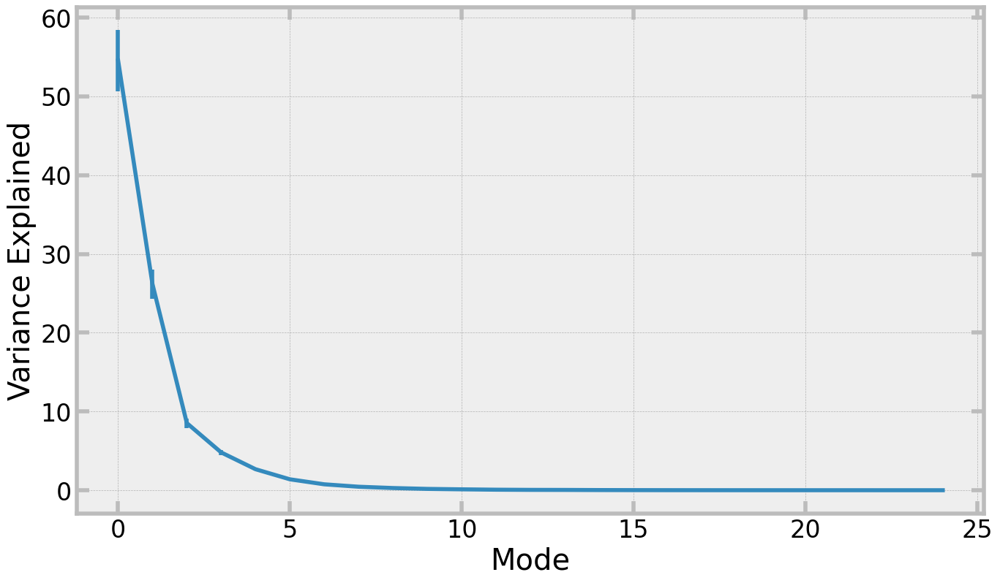

In [30]:
plt.style.use('bmh')
plt.rcParams.update({'font.size':24})

[fig, ax] = plt.subplots(figsize=(16,9))
index = np.arange(len(eigval))
eigenvalue_spectrum = eigval/np.sum(eigval)
spectrum_error = eigval_err

# ax.set_title(f'Eigenvalue Spectrum, {degrees_of_freedom:0.0f} effective degrees of freedom', pad=15)
ax.errorbar(index, 100*eigenvalue_spectrum, 100*spectrum_error, lw=4)
ax.set_ylabel('Variance Explained')
ax.set_xlabel('Mode')

# Configure and label axes
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(4)

ax.tick_params(
    axis='both', which='major', 
    length=12, width=4, 
    color='#bcbcbc', 
    direction='in',
    right=True,
    top=True,
    pad=5
)

### Plot of Leading EOF modes

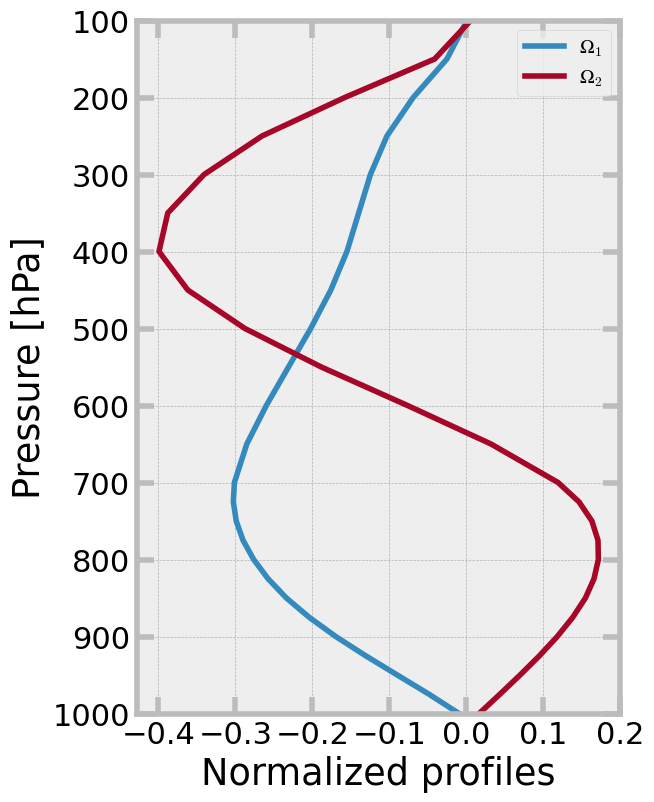

In [31]:
plt.style.use('bmh')
plt.rcParams.update({'font.size':22})

[fig, ax] = plt.subplots(figsize=(16,9))

ax.plot(EOF[0], vertical_wind.lev, lw=4, label=r'$Ω_{1}$')
ax.plot(-EOF[1], vertical_wind.lev, lw=4, label=r'$Ω_{2}$')

ax.invert_yaxis()
ax.set_ylabel('Pressure [hPa]')
ax.set_xlabel('Normalized profiles')
ax.set_ylim(1000, 100)
ax.set_xticks(np.arange(-0.4, 0.4, 0.2))
# ax.set_xlim(-0.4, 0.4)
ax.set_aspect(0.001)
ax.xaxis.set_major_locator(mticker.MaxNLocator(nbins=7, prune='lower'))

ax.legend(loc='upper right', fontsize=14)

# Configure and label axes
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(4)

ax.tick_params(
    axis='both', which='major', 
    length=12, width=4, 
    color='#bcbcbc', 
    direction='in',
    right=True,
    top=True,
    pad=5
)

plt.show()

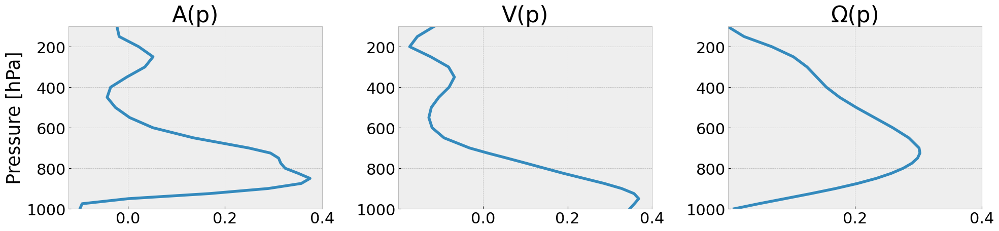

In [33]:
vertical_wind_profile = -EOF[0]
horizontal_wind_profile = -np.gradient(vertical_wind_profile, vertical_wind.lev)
temperature_profile = np.gradient(horizontal_wind_profile, np.log(vertical_wind.lev))

gs = GridSpec(1, 3, width_ratios = [1,1,1])
gs.update(top=.95, bottom=0.05, left=0.05, right=.95, hspace=0, wspace=0.3)

fig = plt.figure(figsize=(20,4))

# Temperature Structure
ax0 = fig.add_subplot(gs[0])
ax0.set_title('A(p)')
ax0.plot(temperature_profile/np.linalg.norm(temperature_profile), vertical_wind.lev, lw=4, label=r'$Ω_{1}$')

ax0.invert_yaxis()
ax0.set_ylabel('Pressure [hPa]')
# ax0.set_xlabel('Normalized profiles')
ax0.set_ylim(1000, 100)
ax0.set_xticks([0, 0.2, 0.4])
# ax.set_xlim(-0.4, 0.4)
ax0.set_aspect('auto')
# ax0.xaxis.set_major_locator(mticker.MaxNLocator(nbins=4, prune='lower'))

# Horizontal wind structure
ax1 = fig.add_subplot(gs[1])
ax1.set_title('V(p)')
ax1.plot(horizontal_wind_profile/np.linalg.norm(horizontal_wind_profile), vertical_wind.lev, lw=4, label=r'$Ω_{1}$')

ax1.invert_yaxis()
ax1.set_ylabel('')
# ax1.set_xlabel('Normalized profiles')
ax1.set_ylim(1000, 100)
ax1.set_xticks([0,0.2, 0.4])
# ax.set_xlim(-0.4, 0.4)
ax1.set_aspect('auto')
# ax1.xaxis.set_major_locator(mticker.MaxNLocator(nbins=7, prune='lower'))

# Vertical wind structure 
ax2 = fig.add_subplot(gs[2])
ax2.set_title('Ω(p)')
ax2.plot(vertical_wind_profile/np.linalg.norm(vertical_wind_profile), vertical_wind.lev, lw=4, label=r'$Ω_{1}$')

ax2.invert_yaxis()
# ax2.set_ylabel('Pressure [hPa]')
# ax2.set_xlabel('Normalized profiles')
ax2.set_ylim(1000, 100)
ax2.set_xlim(0, 0.4)
ax2.set_xticks([0.2, 0.4])
# ax.set_xlim(-0.4, 0.4)
ax2.set_aspect('auto')
# ax2.xaxis.set_major_locator(mticker.MaxNLocator(nbins=3, prune='lower'))

# Examine Precipitation-Column Moisture Relationship

## Calculate column relative humidity

In [9]:
# Column integrate moisture and convert to units of mm
column_integrated_moisture = (1000/WATER_DENSITY)*column_integrate(moisture.fillna(0))
column_integrated_moisture.attrs['units']= 'mm'
column_integrated_moisture.attrs['long_name']= 'Column Water Vapor'

# Calculate saturation vapor pressure in Pa
saturation_vapor_pressure = temperature.copy(deep=True)
saturation_vapor_pressure.values = 10*0.622*np.exp((17.67*(temperature.values-273.15))/(temperature.values-273.15+243.5))

# Calculate saturation specific humidity
saturation_specific_humidity = 0.622*(saturation_vapor_pressure/(saturation_vapor_pressure.lev))

# Column-integerate saturation specific humidity
column_integrated_saturation_specific_humidity = (1000/WATER_DENSITY)*column_integrate(saturation_specific_humidity.fillna(0))

# Calculate column relative humidity
column_relative_humidity = column_integrated_moisture/column_integrated_saturation_specific_humidity

## Maps of CWV and precipitation

In [10]:
# Specify plotting parameters
plt.style.use('default')
plt.rcParams.update({'font.size':20})

# Create GridSpec and figure
gs = GridSpec(2, 2, height_ratios=[1,1], width_ratios=[100,2])
gs.update(top=.95, bottom=0.05, left=0.05, right=.95, hspace=0.3, wspace=0.05)
fig = plt.figure(figsize=(16, 8))
ax = []
cbar_ax = []
cmap_modified = mjo.modified_colormap('coolwarm', 'white', 0.2, 0.2)

#### Column Moisture ####
moisture_keywords = {
    'transform':ccrs.PlateCarree(),
    'cmap':'GnBu',
    'levels':np.linspace(0,60,11),
    'extend':'max'
}

ax.append(fig.add_subplot(gs[0,0], projection=ccrs.PlateCarree(central_longitude=-210)))
cbar_ax.append(fig.add_subplot(gs[0,1]))

ax[0].set_title(
    r'Time mean column integrated moisture', 
    pad=15
)

# Plot column moisture
cf = ax[0].contourf(
    column_integrated_moisture.lon, 
    column_integrated_moisture.lat, 
    column_integrated_moisture.mean(dim='time'),
    **moisture_keywords
)

# Colorbar
cbar0 = fig.colorbar(cf, cax=cbar_ax[0])
cbar0.set_label(column_integrated_moisture.attrs['units'])

# Add cyclic point
cdata, clon = cutil.add_cyclic_point(
    column_integrated_moisture.mean(dim='time'),
    coord=column_integrated_moisture.lon
)

# Plot cyclic point
ax[0].contourf(
    clon, 
    column_integrated_moisture.lat, 
    cdata, 
    **moisture_keywords
)
#######################

#### PRECIPITATION ####
precip_keywords = {
    'transform':ccrs.PlateCarree(),
    'cmap':'GnBu',
    'norm':mcolors.LogNorm(),
    'levels':np.linspace(0,1,11),
    'extend':'max'
}

ax.append(fig.add_subplot(gs[1,0], projection=ccrs.PlateCarree(central_longitude=-210)))
cbar_ax.append(fig.add_subplot(gs[1,1]))

ax[1].set_title(
    r'Time mean precipitation', 
    pad=15
)

# Plot precipitation
cf = ax[1].contourf(
    precipitation.lon, 
    precipitation.lat, 
    3600*precipitation.mean(dim='time'),
    **precip_keywords
)

# Colorbar
cbar1 = fig.colorbar(cf, cax=cbar_ax[1])
cbar1.set_label(r'mm day$^{-1}$')

# Add cyclic point
cdata, clon = cutil.add_cyclic_point(
    3600*precipitation.mean(dim='time'),
    coord=precipitation.lon
)

# Plot cyclic point
ax[1].contourf(
    clon, 
    precipitation.lat, 
    cdata, 
    **precip_keywords
)

# Configure axes and gridlines
for axis in range(2):
    ax[axis].add_feature(cfeature.COASTLINE, lw=2)

    gl = ax[axis].gridlines(
        crs=ccrs.PlateCarree(),
        draw_labels=True,
        linewidth=1,
        color="gray",
        alpha=0.75,
        linestyle="--",
        zorder=100
        )

    gl.left_labels = True
    gl.right_labels = False
    gl.top_labels = False
    gl.bottom_labels = True
    gl.xlocator = mticker.FixedLocator(np.arange(-180,180,30))
    gl.xformatter = LongitudeFormatter()
    gl.xlabel_style = {'fontsize':20}
    gl.ylocator = mticker.FixedLocator(np.arange(-40,40,10))
    gl.yformatter = LatitudeFormatter()
    gl.ylabel_style = {'fontsize':20}

    ax[axis].set_aspect('auto')

AttributeError: 'GeoAxes' object has no attribute '_autoscaleXon'

Error in callback <function _draw_all_if_interactive at 0x7f40f88b8430> (for post_execute):


ValueError: zero-size array to reduction operation minimum which has no identity

ValueError: zero-size array to reduction operation minimum which has no identity

<Figure size 1600x800 with 2 Axes>

## 2D Histogram of P vs CWV

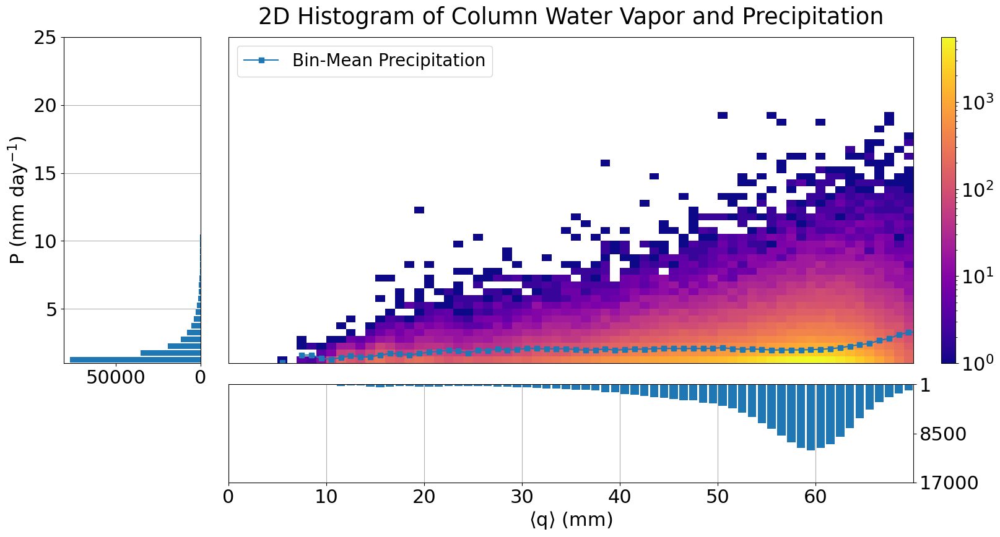

In [83]:
plt.style.use('default')
plt.rcParams.update({'font.size':22})

# Create gridspec and figure
fig = plt.figure(figsize=(16, 8))
gs = GridSpec(2, 3, height_ratios=[10,3], width_ratios=[2, 10,0.2])
gs.update(top=.95, bottom=0.05, left=0.05, right=.95, hspace=0.1, wspace=0.1)

ax = []
ax.append(fig.add_subplot(gs[0,1]))
ax.append(fig.add_subplot(gs[1,1]))
ax.append(fig.add_subplot(gs[0,0]))

cbar_ax = []
cbar_ax.append(fig.add_subplot(gs[0,2]))

precip_threshold = 1
prec = 3600*precipitation.sel(time=slice(column_integrated_moisture.time[0], column_integrated_moisture.time[-1]))
prec = prec.where(moisture["time.month"].isin([1,2,3,4,11,12]), drop=True)
threshold = (prec >= precip_threshold)
prec = prec.where(threshold, drop=True)
prec = prec.values.flatten()
precipitation_bins = np.arange(precip_threshold,20,0.5)

clm = column_integrated_moisture.where(threshold, drop=True)
clm = clm.values.flatten()
moisture_bins = np.arange(0, 75, 1)
bar_widths = 0.85

# slope = np.polyfit(clm, prec, 1)[0]

#### 2D Histogram ####
ax[0].set_title('2D Histogram of Column Water Vapor and Precipitation', pad=15)
im = ax[0].hist2d(
    clm,
    prec,
    bins=[moisture_bins,precipitation_bins],
    cmap='plasma',
    norm=mcolors.LogNorm(),
    density=False
)

cbar = fig.colorbar(im[3], cax=cbar_ax[0])

ax[0].set_xlim(0, 70)
ax[0].set_ylim(precip_threshold, 25)
ax[0].set_xticks([])
ax[0].set_yticks([])
ax[0].grid(axis="both")

#### Bin-Mean Precipitation ####
bin_width = 1
bin_means, bin_edges, binnumber = sp.stats.binned_statistic(clm, prec, 'mean', bins=np.arange(0,75,bin_width))
bin_centers = bin_edges[1:] - bin_width/2
ax[0].plot(bin_centers, bin_means, 's-', label='Bin-Mean Precipitation')
ax[0].legend(loc='upper left', fontsize=20)

#### Column Moisture Histogram ####
clm_values = ax[1].hist(
    clm,
    bins = moisture_bins,
    rwidth = bar_widths,
    density=False
)
ax[1].set_xlim(0, 70)
ax[1].set_xlabel(r'$\langle$q$\rangle$ (mm)')
# ax[1].set_ylabel('Count')
ax[1].xaxis.set_major_locator(mticker.MaxNLocator(nbins=7, prune='upper'))
upper_bound = round(1.5*clm_values[0].max()/1000)*1000
ax[1].set_ylim(precip_threshold, upper_bound)
ax[1].set_yticks([precip_threshold, upper_bound//2, upper_bound])
ax[1].invert_yaxis()
ax[1].yaxis.set_label_position("right")
ax[1].yaxis.tick_right()
ax[1].grid(axis="x")

#### Precipitation Histogram ####
ax[2].hist(
    prec,
    orientation = "horizontal",
    bins = precipitation_bins,
    rwidth = bar_widths,
    density=False
)
ax[2].invert_xaxis()
# ax[2].set_xlabel('Count')
ax[2].xaxis.set_major_locator(mticker.MaxNLocator(nbins=2, prune='upper'))
ax[2].set_ylim(precip_threshold,25)
ax[2].set_ylabel('P (mm day$^{-1}$)')
ax[2].grid(axis="y")

plt.show()

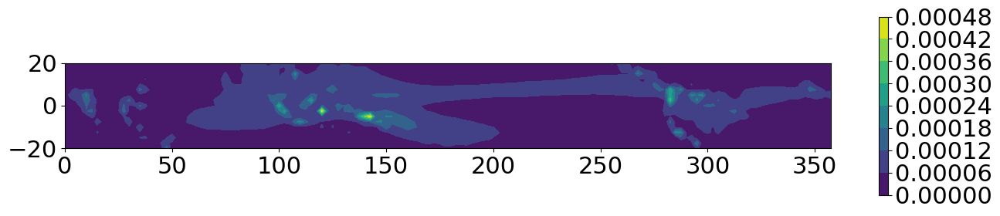

In [94]:
plt.figure(figsize=(16,3))
plt.contourf(
    precipitation.lon,
    precipitation.lat,
    precipitation.mean(dim='time'))
plt.colorbar()
plt.gca().set_aspect('equal')

## Time Series Analysis

In [ ]:
# Indian Ocean
indian_ocean = {'lon':slice(60,90), 'lat':slice(-5,5)}
indian_ocean_point = {'lon':75, 'lat':0}
indian_ocean_precipitation = precipitation.sel(indian_ocean)#.mean(dim=['lat', 'lon'])

indian_ocean_column_moisture = column_integrated_moisture.sel(indian_ocean)#.mean(dim=['lat','lon'])

normalized_io_precipitation = (
    indian_ocean_precipitation - indian_ocean_precipitation.mean(dim='time')
) / indian_ocean_precipitation.std(dim='time')
normalized_io_column_moisture = (
    indian_ocean_column_moisture - indian_ocean_column_moisture.mean(dim='time')
) / indian_ocean_column_moisture.std(dim='time')

# Maritime Continent
maritime_continent = {'lon':slice(90,120), 'lat':slice(-5,5)}
maritime_continent_point = {'lon':75, 'lat':0}
maritime_continent_precipitation = precipitation.sel(maritime_continent)#.mean(dim=['lat', 'lon'])

maritime_continent_column_moisture = column_integrated_moisture.sel(maritime_continent)#.mean(dim=['lat','lon'])

normalized_mc_precipitation = (
    maritime_continent_precipitation - maritime_continent_precipitation.mean(dim='time')
) / maritime_continent_precipitation.std(dim='time')
normalized_mc_column_moisture = (
    maritime_continent_column_moisture - maritime_continent_column_moisture.mean(dim='time')
) / maritime_continent_column_moisture.std(dim='time')

# Filtering
low_pass_filtered_io_precipitation = mjo.lanczos_lowpass_filter(normalized_io_precipitation, 1/20, 1)
low_pass_filtered_io_column_moisture = mjo.lanczos_lowpass_filter(normalized_io_column_moisture, 1/20, 1)

band_pass_filtered_io_precipitation = mjo.lanczos_bandpass_filter(normalized_io_precipitation, 1/100, 1/20, 1, filter_axis=0)
band_pass_filtered_io_column_moisture = mjo.lanczos_bandpass_filter(normalized_io_column_moisture, 1/100, 1/20, 1, filter_axis=0)

high_pass_filtered_io_precipitation = mjo.lanczos_highpass_filter(normalized_io_precipitation, 1/20, 1)
high_pass_filtered_io_column_moisture = mjo.lanczos_highpass_filter(normalized_io_column_moisture, 1/20, 1)

# Plot data
plt.style.use('bmh')
plt.figure(figsize=(16,9))

# Full
plt.scatter(
    normalized_io_column_moisture, 
    normalized_io_precipitation, 
    alpha=0.5,
    label='IO Full',
)

# Full
plt.scatter(
    normalized_mc_column_moisture, 
    normalized_mc_precipitation, 
    alpha=0.5,
    label='MC Full',
)

# # Low-pass
# plt.scatter(
#     low_pass_filtered_io_column_moisture, 
#     low_pass_filtered_io_precipitation,
#     alpha=0.5,
#     label='Low-Pass'
# )

# # Band-pass
# plt.scatter(
#     band_pass_filtered_io_column_moisture, 
#     band_pass_filtered_io_precipitation, 
#     alpha=0.5,
#     label='Band-Pass'
# )

# # High-pass
# plt.scatter(
#     high_pass_filtered_io_column_moisture, 
#     high_pass_filtered_io_precipitation, 
#     alpha=0.5,
#     label='High-Pass'
# )

# Configure axes
plt.legend(loc='upper left')
plt.xlabel('Column Moisture')
plt.ylabel('Precipitation')

plt.show()